Unfortunatley, I was not able to find a significant trend or time-lag with Granger causality. Thus, Let me just try simple Pearson's correlation over the days. In addition, the correlation between case-fatality ratio and accessiblity doesn't show a significant reseult. I will just try accessibility vs. death. 

In [1]:
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import pearsonr, spearmanr
from statsmodels.stats.multitest import fdrcorrection
from statsmodels.tsa.stattools import adfuller, kpss, grangercausalitytests
from tqdm import tqdm
import datetime
import os

# Data

In [56]:
from_date = '2020-07-01'
to_date = '2021-12-31'

start_date = datetime.datetime.strptime(from_date,  "%Y-%m-%d")
end_date = datetime.datetime.strptime(to_date,  "%Y-%m-%d")

focus_date = []
delta = datetime.timedelta(days=1)
while start_date <= end_date:
    focus_date.append(start_date.strftime("%m/%d/%Y"))
    start_date += delta

In [57]:
access = gpd.read_file("./data/processed_data/ICU_access_measures/ICU_access_county.shp")
access.head()

,index,NAME,06/01/2020,06/02/2020,06/03/2020,06/04/2020,06/05/2020,06/06/2020,06/07/2020,06/08/2020,...,12/23/2021,12/24/2021,12/25/2021,12/26/2021,12/27/2021,12/28/2021,12/29/2021,12/30/2021,12/31/2021,geometry
0,48327,Menard,0.481450,0.504673,0.494921,0.359804,0.380861,0.416848,0.445366,0.463968,...,0.057078,0.055447,0.057775,0.058969,0.056747,0.050579,0.046795,0.044798,0.042296,"POLYGON ((-99.77120 30.71079, -99.78240 30.710..."
1,48189,Hale,2.661175,2.398550,2.288703,0.672046,0.550668,0.580442,0.673039,0.691939,...,0.007549,0.006805,0.006247,0.005544,0.004431,0.004738,0.004571,0.004513,0.003913,"POLYGON ((-101.73504 33.82864, -101.73507 33.8..."
2,48011,Armstrong,0.008839,0.008874,0.009701,0.009687,0.008540,0.009005,0.009563,0.009912,...,0.001716,0.001967,0.002158,0.002462,0.002360,0.002270,0.002396,0.002478,0.002131,"POLYGON ((-101.08728 35.02708, -101.08729 35.0..."
3,48057,Calhoun,2.364419,1.663282,1.490708,0.618558,0.560262,0.519041,0.482546,0.417936,...,0.138889,0.120955,0.109047,0.109674,0.100102,0.084663,0.076442,0.073078,0.062078,"POLYGON ((-96.35229 28.50953, -96.35241 28.508..."
4,48077,Clay,1.756416,1.993939,1.554681,0.504286,0.399408,0.381449,0.362439,0.333911,...,0.001702,0.002336,0.003988,0.003731,0.004190,0.003748,0.004242,0.005163,0.004003,"POLYGON ((-97.97784 33.81417, -97.97784 33.813..."


In [58]:
death = pd.read_csv('./data/processed_data/relationship/daily_death.csv')
death['index'] = death['index'].astype(str)
death.head()

,Unnamed: 0,06/01/2020,06/02/2020,06/03/2020,06/04/2020,06/05/2020,06/06/2020,06/07/2020,06/08/2020,06/09/2020,...,12/25/2021,12/26/2021,12/27/2021,12/28/2021,12/29/2021,12/30/2021,12/31/2021,TSA,index,NAME
0,0,0,0,0,0,0,0,0,0,0,...,0,1,0,1,0,0,0,G,48001,Anderson
1,1,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,J,48003,Andrews
2,2,0,0,0,1,0,0,1,0,1,...,0,0,0,0,1,0,0,H,48005,Angelina
3,3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,U,48007,Aransas
4,4,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,C,48009,Archer


In [59]:
def standardize(ary):
    ary_ = ary.copy()
    ary_ = ary_.astype('float64')
    
    for idx, val in enumerate(ary):
        ary_[idx] = (val - ary.mean()) / ary.std()
        
    return ary_

In [60]:
access.loc[access['index'] == fips, focus_date].values[0]

array([0.0465612 , 0.04344966, 0.03809759, 0.03624733, 0.03403903,
       0.03059995, 0.02762393, 0.02874342, 0.02673559, 0.0259192 ,
       0.024931  , 0.02572132, 0.02518833, 0.02367277, 0.02040652,
       0.01883659, 0.0182058 , 0.01828611, 0.01722039, 0.01747368,
       0.01829637, 0.01966801, 0.019477  , 0.02010172, 0.02204082,
       0.02386263, 0.02409369, 0.02446941, 0.02506822, 0.02519064,
       0.02501145, 0.02608558, 0.02685115, 0.0257541 , 0.02414255,
       0.02102738, 0.01963351, 0.0181756 , 0.0160731 , 0.01495005,
       0.0154859 , 0.01637868, 0.01719717, 0.01831653, 0.0190626 ,
       0.02046961, 0.0209693 , 0.02054183, 0.02214412, 0.02360619,
       0.02427124, 0.02473018, 0.02527353, 0.02713503, 0.02807949,
       0.02784346, 0.02789001, 0.02871521, 0.03015077, 0.03271117,
       0.03556024, 0.03676641, 0.03915274, 0.04035712, 0.04008097,
       0.03962191, 0.04306405, 0.04607623, 0.04949062, 0.04762521,
       0.04191494, 0.03539434, 0.03215863, 0.03029285, 0.03046

In [61]:
pearson_dict = dict()

for fips in access['index']:

    acc_ts = access.loc[access['index'] == fips, focus_date].values[0]
#     acc_ts = standardize(acc_ts)
    
    death_ts = death.loc[death['index'] == fips, focus_date].values[0]
#     death_ts = standardize(death_ts)
    
    pearr, pearp = pearsonr(acc_ts, death_ts)
    pearson_dict[fips] = dict()
    pearson_dict[fips]["coef"] = pearr
    pearson_dict[fips]["pval"] = pearp
    
pearson_dict

/Users/zawoon96/opt/anaconda3/envs/sa/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4068: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/zawoon96/opt/anaconda3/envs/sa/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4068: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/zawoon96/opt/anaconda3/envs/sa/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4068: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/zawoon96/opt/anaconda3/envs/sa/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4068: PearsonRConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(PearsonRConstantInputWarning())
/Users/zawoo

{'48327': {'coef': -0.08403371800012988, 'pval': 0.049071816653407596},
 '48189': {'coef': -0.2125505050412934, 'pval': 4.997409247715628e-07},
 '48011': {'coef': -0.051580024420318504, 'pval': 0.22758342073166818},
 '48057': {'coef': -0.0722584697391793, 'pval': 0.09075610203004172},
 '48077': {'coef': -0.1419358483035063, 'pval': 0.0008530491908425044},
 '48361': {'coef': -0.32233846350460277, 'pval': 9.70692602187578e-15},
 '48177': {'coef': -0.25324299054918736, 'pval': 1.7600990212807336e-09},
 '48147': {'coef': -0.31793497866918297, 'pval': 2.322700417882686e-14},
 '48265': {'coef': -0.2803704060316415, 'pval': 2.248023562219981e-11},
 '48391': {'coef': -0.16014847484516614, 'pval': 0.00016443273565957883},
 '48247': {'coef': nan, 'pval': nan},
 '48127': {'coef': -0.1275155113984775, 'pval': 0.00276067311515902},
 '48353': {'coef': -0.16422404622425402, 'pval': 0.00011090906181963123},
 '48041': {'coef': -0.3839674152632451, 'pval': 9.966092921262032e-21},
 '48245': {'coef': -0.4

In [62]:
coefs = [pearson_dict[ind]["coef"] for ind in access["index"]]
pvals = [pearson_dict[ind]["pval"] for ind in access["index"]]
pearson_df = pd.DataFrame({"index": access["index"], "coefs": coefs, "pvals": pvals})
pearson_df.head()

,index,coefs,pvals
0,48327,-0.084034,4.907182e-02
1,48189,-0.212551,4.997409e-07
2,48011,-0.051580,2.275834e-01
3,48057,-0.072258,9.075610e-02
4,48077,-0.141936,8.530492e-04


In [63]:
pearson_gdf = access[['index', 'geometry']].copy(deep=True)
pearson_gdf = pearson_gdf.merge(pearson_df, on="index")
pearson_gdf.head()

,index,geometry,coefs,pvals
0,48327,"POLYGON ((-99.77120 30.71079, -99.78240 30.710...",-0.084034,4.907182e-02
1,48189,"POLYGON ((-101.73504 33.82864, -101.73507 33.8...",-0.212551,4.997409e-07
2,48011,"POLYGON ((-101.08728 35.02708, -101.08729 35.0...",-0.051580,2.275834e-01
3,48057,"POLYGON ((-96.35229 28.50953, -96.35241 28.508...",-0.072258,9.075610e-02
4,48077,"POLYGON ((-97.97784 33.81417, -97.97784 33.813...",-0.141936,8.530492e-04


<AxesSubplot:>

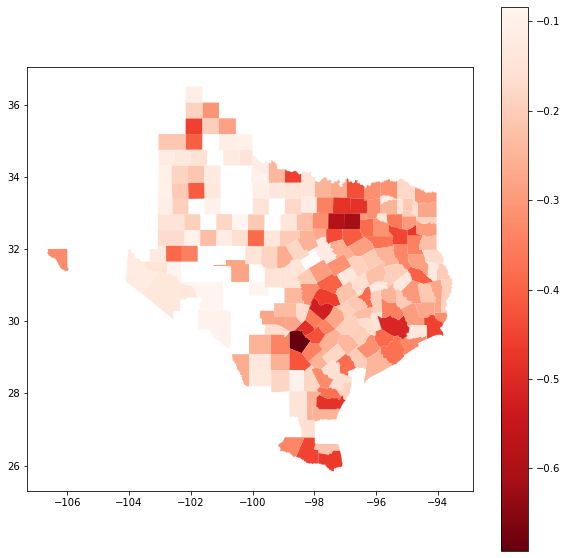

In [64]:
pearson_p05 = pearson_gdf[pearson_gdf["pvals"] <= 0.05]
pearson_p05.plot(column="coefs", figsize=(10, 10), legend=True, cmap='Reds_r')

In [65]:
pearson_p05.explore('coefs')

# Trend visualization

In [66]:
county_names = {'Harris': '48201', # Houston
                'Dallas': '48113', # Dallas
                'Tarrant': '48439', # Fort Worth
                'Bexar': '48029', # San Antonio
                'Travis': '48453', # Austin
                'El Paso': '48141'
               }

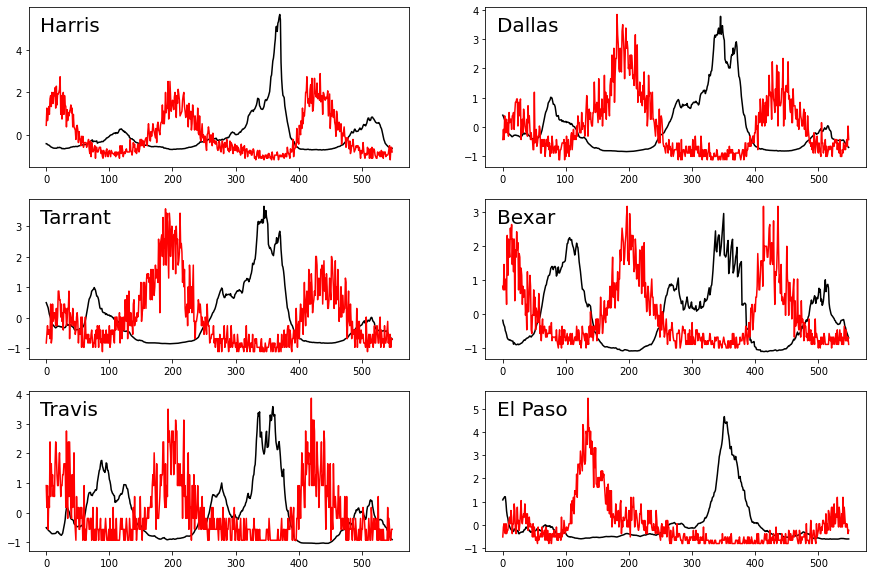

In [77]:
county_names = {'Harris': '48201', # Houston
                'Dallas': '48113', # Dallas
                'Tarrant': '48439', # Fort Worth
                'Bexar': '48029', # San Antonio
                'Travis': '48453', # Austin
                'El Paso': '48141'
               }

fig, axes = plt.subplots(3, 2, figsize=(15, 10))

axes_ = axes.reshape(-1)

for idx, (cName, cCode) in enumerate(county_names.items()):
#     print(cName, cCode)

    acc_ts = access.loc[access['index'] == cCode, focus_date].values[0]
    acc_ts = standardize(acc_ts)
    
    death_ts = death.loc[death['index'] == cCode, focus_date].values[0]
    death_ts = standardize(death_ts)
    
    axes_[idx].plot(range(len(acc_ts)), acc_ts, label='Access', color='black')
    axes_[idx].plot(range(len(death_ts)), death_ts, label='Death', color='red')
    
    axes_[idx].text(0.03, 0.85, cName, fontsize=20, transform=axes_[idx].transAxes)